# Project 2 Comparing Airline Networks for Mergers with 2-Node Dataset
Shariq Mian

## Importing Libraries

In [20]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import json
import csv
from networkx.algorithms import bipartite as bi

## Data Load

In [21]:
#DOT DB28 Dataset
df=pd.read_csv('https://github.com/mianshariq/Datasets/raw/401a2445f83e1456cc10c4cf6ba3c52c61620521/airport_2019_sup.csv')

<ipython-input-21-b6a3f41ac7f1>:2: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('https://github.com/mianshariq/Datasets/raw/401a2445f83e1456cc10c4cf6ba3c52c61620521/airport_2019_sup.csv')


In [22]:
df.sample(5)

,Month,Origin,Dest,Carrier,Carrier_group_Code,Distance,Act_type_code,Airraft_Confg,Dep_Performed,Avail_Payload_Cap,Avail_Seats,Pax_Trasported,Freight_Transported,Ramp_min,Airborne_Min,LegacyvsLowcost,Unnamed: 16,Unnamed: 17
203206,2,LAX,SAN,OO,3,109,29,1,51,664000,2550,1929,0,2778,1451,Private,NaN,NaN
240152,9,MOU,PQS,H6,1,26,16,3,25,85000,225,102,347,497,373,Private,NaN,NaN
342197,9,SEA,SAT,AS,3,1774,88,1,56,2582400,9968,7871,7346,13517,11928,Legacy,NaN,NaN
46056,3,BOS,IAH,UA,3,1597,34,1,7,273222,1253,1033,9,1804,1614,Legacy,NaN,NaN
212396,3,LNK,DEN,AX,1,423,75,1,51,567018,2550,2147,0,5000,3705,Private,NaN,NaN



### Selecting Data from Dec 2019

In [23]:
df=df[df["Month"]==12]

In [24]:
df.sample(5)

,Month,Origin,Dest,Carrier,Carrier_group_Code,Distance,Act_type_code,Airraft_Confg,Dep_Performed,Avail_Payload_Cap,Avail_Seats,Pax_Trasported,Freight_Transported,Ramp_min,Airborne_Min,LegacyvsLowcost,Unnamed: 16,Unnamed: 17
194299,12,LAS,LAX,WN,3,236,14,1,11,477400,1925,1668,1320,738,482,LowCost,NaN,NaN
389481,12,XNA,DEN,OO,3,616,31,1,24,449760,1680,1532,0,2970,2327,Private,NaN,NaN
65630,12,CLT,ATL,YX,3,226,73,1,23,501469,1748,1184,0,1919,1078,Private,NaN,NaN
192066,12,LAS,BOI,G4,3,519,98,1,1,31200,156,152,0,108,78,LowCost,NaN,NaN
179190,12,JFK,MSP,DL,3,1029,23,1,2,57280,218,202,167,410,274,Legacy,NaN,NaN


## NetworkX Graph

## Creating basic NetworkX Graph



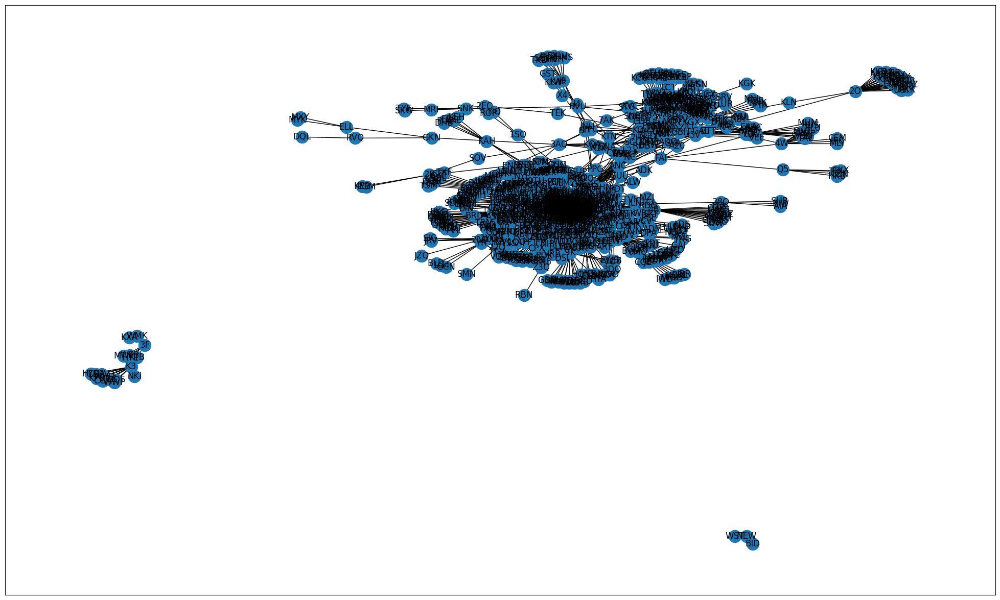

In [25]:
G=nx.Graph()
G=nx.from_pandas_edgelist(df, 'Origin', 'Carrier',edge_attr='Pax_Trasported',create_using=nx.Graph())
plt.figure(figsize=(25,15))
nx.draw_networkx(G, with_labels=True)

In [26]:
nx.is_bipartite(G)

True

### There are 3 Connected Components

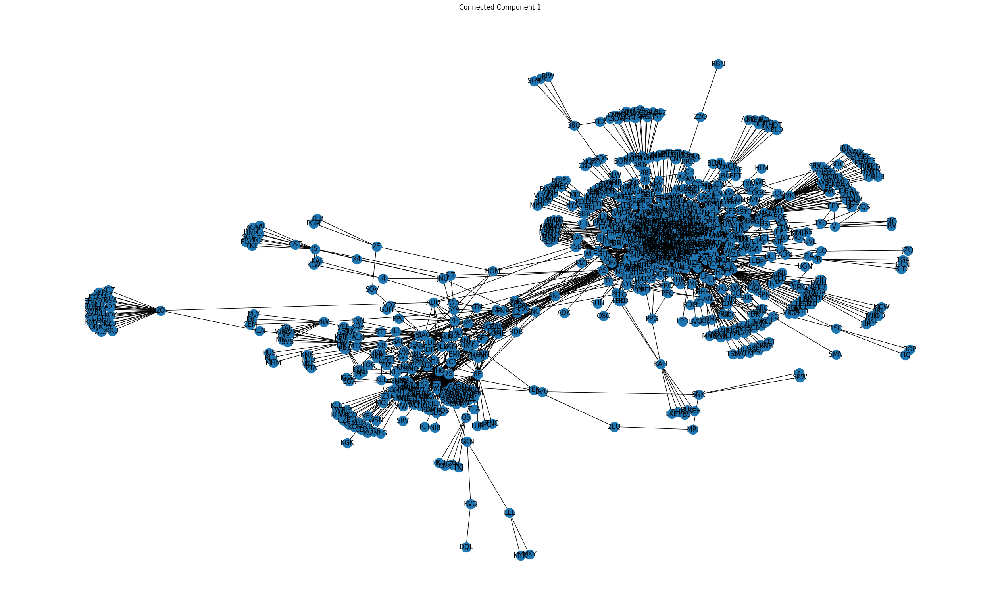

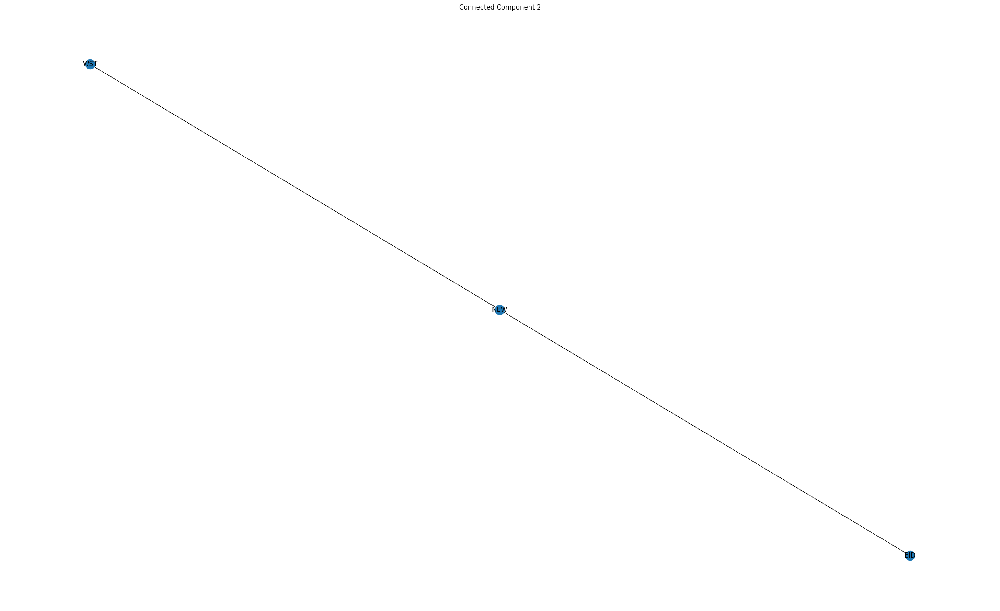

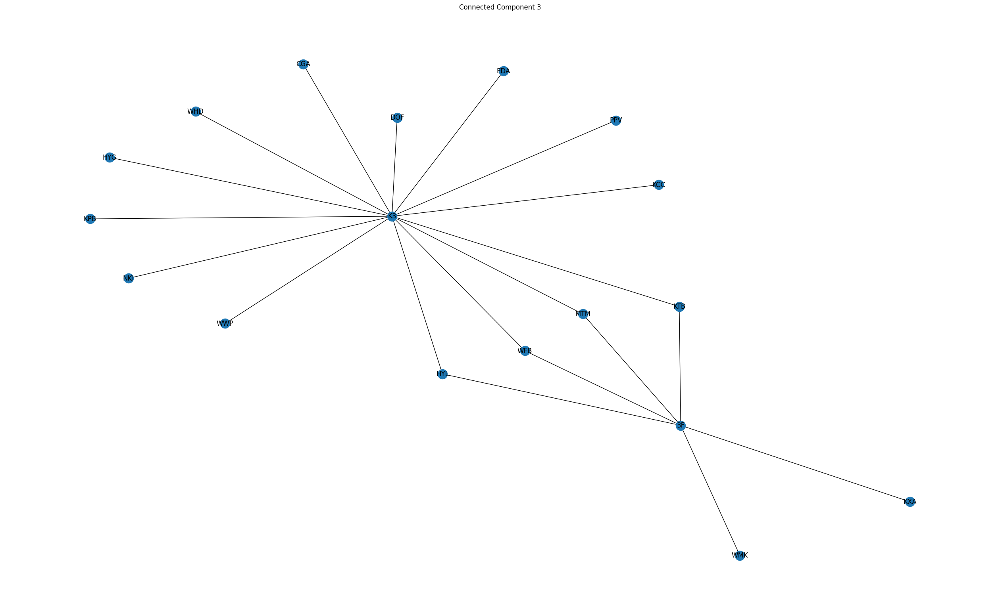

In [27]:
connected_components = nx.connected_components(G)

# Iterate over each connected component
for i, component in enumerate(connected_components, start=1):
    plt.figure(figsize=(25,15))
    subgraph = G.subgraph(component)

    nx.draw(subgraph, with_labels=True)
    plt.title(f"Connected Component {i}")
    plt.show()

## Modifying NetworkX Graph




## Creating table of Metrics

 Eigenvector centrality measures the influence or importance of a node in a network. It considers both the node's own centrality and the centrality of its neighboring nodes. Nodes with higher eigenvector centrality values are considered more influential within the network.

 Betweenness centrality values: allowing you to identify the nodes that act as bridges or key connectors in the graph's communication network. Here UA has the higest betweeness, which means it has the mose diverse set of aircrafts

In [28]:
G=nx.from_pandas_edgelist(df, 'Origin', 'Carrier',edge_attr='Pax_Trasported',create_using=nx.Graph())
plt.figure(figsize=(25,15))
degree_centrality = nx.degree_centrality(G)

# Calculate eigenvector centrality
eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=1000, tol=1e-6)
betweenness_centrality = nx.betweenness_centrality(G)
closeness_centrality = nx.closeness_centrality(G)


# Create a DataFrame to store the centrality measures
centrality_df = pd.DataFrame({
    'Node': G.nodes(),
    'Degree Centrality': degree_centrality.values(),
    'Eigenvector Centrality': eigenvector_centrality.values(),
    'Betweenness Centrality': betweenness_centrality.values(),
    'Closeness_centrality' : closeness_centrality.values(),
})

# Sort the DataFrame by Degree Centrality in descending order
centrality_df.sort_values('Degree Centrality', ascending=False, inplace=True)

# Print the centrality measures in the desired format
centrality_df

,Node,Degree Centrality,Eigenvector Centrality,Betweenness Centrality,Closeness_centrality
23,OO,0.273404,2.127846e-01,0.118325,0.337010
25,FX,0.254255,1.932837e-01,0.238288,0.401102
27,09Q,0.175532,1.604402e-01,0.050354,0.320196
18,DL,0.174468,1.886291e-01,0.068099,0.361994
28,MQ,0.170213,1.629994e-01,0.031974,0.314590
...,...,...,...,...,...
638,MYK,0.001064,6.337268e-09,0.000000,0.142118
637,MXY,0.001064,6.337268e-09,0.000000,0.142118
635,MWA,0.001064,2.760191e-04,0.000000,0.218712
313,ELV,0.001064,2.319039e-06,0.000000,0.172982


<Figure size 2500x1500 with 0 Axes>

In [29]:
deg=nx.degree(G)
degrees = dict(G.degree())
max(degrees.values())

257

In [30]:
deg["B6"]

68

### Nodes color coded based on From/To.

In [31]:
G=nx.Graph()
#G=nx.from_pandas_edgelist(df, 'Origin', 'Carrier',['Distance', 'Pax_Trasported'],create_using=nx.MultiGraph())
#G=nx.from_pandas_edgelist(df, 'Origin', 'Carrier',edge_attr='Distance',create_using=nx.MultiGraph())
G=nx.from_pandas_edgelist(df, 'Origin', 'Carrier',edge_attr='Pax_Trasported',create_using=nx.MultiGraph())
plt.figure(figsize=(25,15))
# Define the colors for Origin and Carrier groups
origin_color = 'blue'
carrier_color = 'orange'

# Create dictionaries to store node colors for each group
origin_node_colors = {}
carrier_node_colors = {}

# Create subgraphs for Origin and Carrier groups
origin_nodes = df['Origin'].unique().tolist()
carrier_nodes = df['Carrier'].unique().tolist()

origin_subgraph = G.subgraph(origin_nodes)
carrier_subgraph = G.subgraph(carrier_nodes)

# Iterate over nodes and assign colors based on groups
for node in G.nodes:
    if node in df['Origin'].unique():
        origin_node_colors[node] = origin_color
    elif node in df['Carrier'].unique():
        carrier_node_colors[node] = carrier_color


<Figure size 2500x1500 with 0 Axes>

### Adding Weights to Edges based on Pax Transported

In [13]:
# Extract the pax_transported as edge weights
edge_weights = [G.edges[edge]['Pax_Trasported'] for edge in G.edges]

# Normalize the edge weights for thickness adjustment
max_weight = max(edge_weights)
min_weight = min(edge_weights)
normalized_weights = [(weight - min_weight) / (max_weight - min_weight) for weight in edge_weights]

### Graph 1.0: Yellow represent the Carrier, Blue represent the Airport

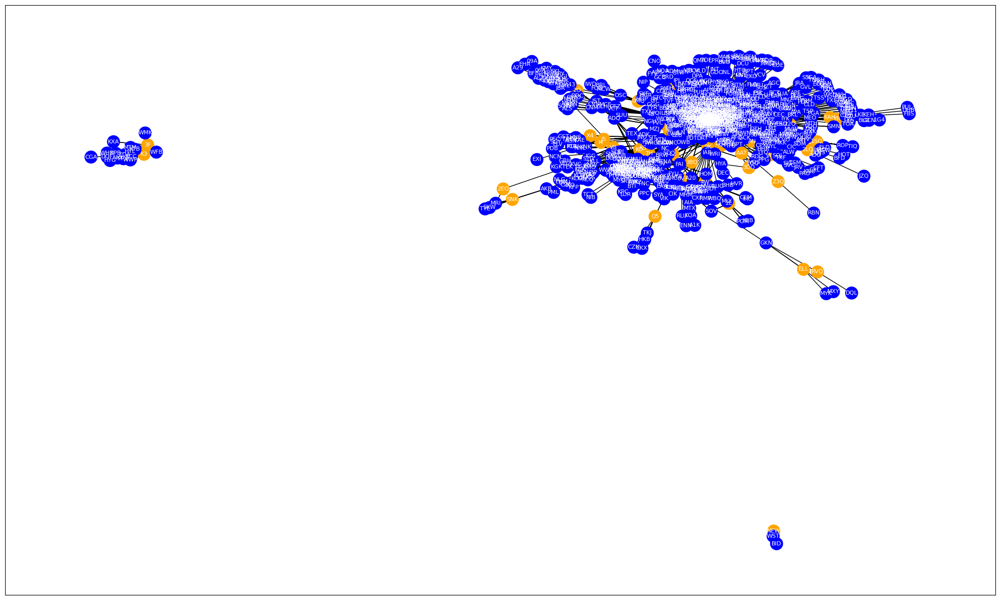

In [14]:
# Draw the graph with node colors based on the groups
plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, node_color=[origin_node_colors.get(node, carrier_node_colors.get(node)) for node in G.nodes],font_size=8, font_color='white')

# Display the graph
plt.show()

## Trying different spring layouts to visualize entire network.

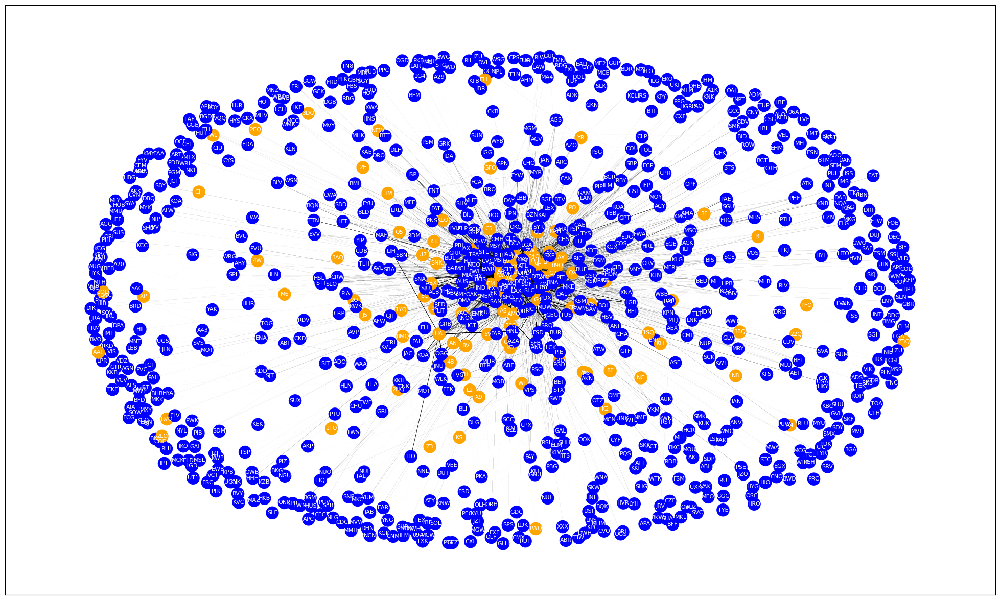

In [12]:
# Draw the graph with node colors based on the groups and edge thickness
plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G, k=.6, iterations=50)
nx.draw_networkx_nodes(G, pos, node_color=[origin_node_colors.get(node, carrier_node_colors.get(node)) for node in G.nodes])
nx.draw_networkx_labels(G, pos,font_size=8, font_color='white' )
nx.draw_networkx_edges(G, pos, width=normalized_weights)

## Trying random layouts to visualize entire network. And color coding Delta Network

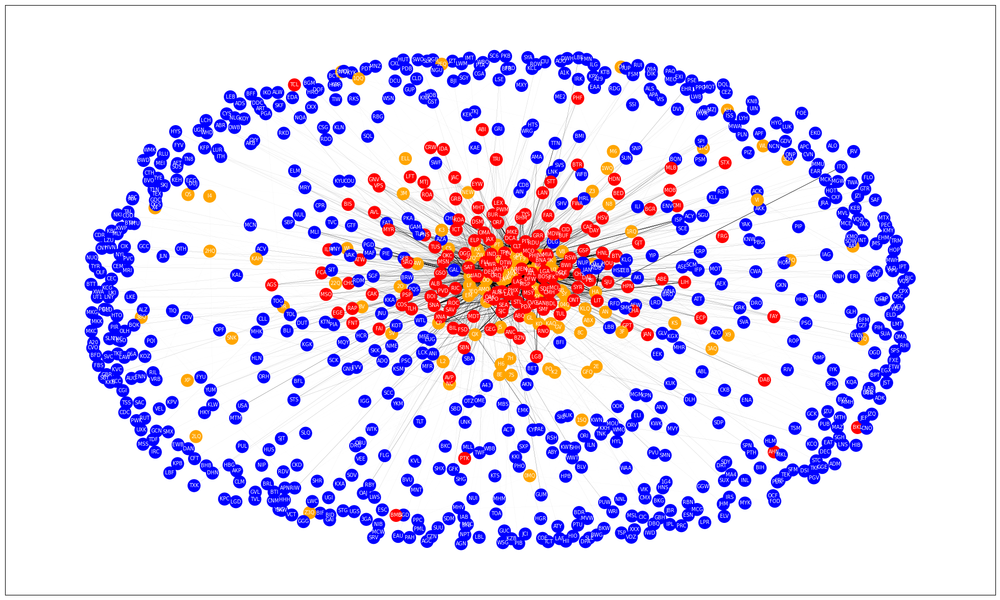

In [13]:
highlighted_color = 'red'
# Highlight a specific node and its edges
highlighted_node = 'DL'  # Replace 'node_name' with the actual name of the node you want to highlight

# Assign the highlighted color to the node and its incident edges
origin_node_colors[highlighted_node] = highlighted_color
for edge in G.edges(highlighted_node):
    origin_node_colors[edge[1]] = highlighted_color

plt.figure(figsize=(25, 15))
# Draw the graph with node colors based on the groups
#pos = nx.spring_layout(G,seed=42, k=2, iterations=50)
#pos = nx.spectral_layout(G)
#pos = nx.multipartite_layout(G)
pos = nx.spring_layout(G, k=.6, iterations=50)
nx.draw_networkx(
    G,
    pos,
    with_labels=True,
    node_color=[origin_node_colors.get(node, carrier_node_colors.get(node)) for node in G.nodes],
    edge_color='black',
    width=normalized_weights,  # Use the normalized weights as edge thickness
    font_size=7, font_color='white'
)


In [14]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_carrier_network(G, carrier1, carrier2):
    # Find matching nodes
    matching_nodes = [node for node in G.nodes if node != carrier1 and node != carrier2 and G.has_edge(node, carrier1) and G.has_edge(node, carrier2)]

    plt.figure(figsize=(25, 15))

    # Draw the graph with node colors and transparency
    pos = nx.spring_layout(G, k=.6, iterations=50,seed=42)

    # Draw non-matching nodes for carrier1 in blue
    carrier1_color = 'blue'
    non_matching_carrier1_nodes = [node for node in G.nodes if node != carrier1 and not G.has_edge(node, carrier2)]
    nx.draw_networkx_nodes(G, pos, nodelist=non_matching_carrier1_nodes, node_size=200, node_color=carrier1_color)

    # Draw non-matching nodes for carrier2 in a different color
    non_matching_carrier2_nodes = [node for node in G.nodes if node != carrier2 and not G.has_edge(node, carrier1)]
    other_color = 'orange'  # Set the color for the remaining nodes
    nx.draw_networkx_nodes(G, pos, nodelist=non_matching_carrier2_nodes, node_size=200, node_color=other_color)

    # Draw matching nodes in green
    matching_color = 'green'
    nx.draw_networkx_nodes(G, pos, nodelist=matching_nodes, node_size=200, node_color=matching_color)

    # Draw carrier1 nodes in blue
    carrier1_nodes = [node for node in G.nodes if node == carrier1]
    nx.draw_networkx_nodes(G, pos, nodelist=carrier1_nodes, node_size=200, node_color=carrier1_color)

    # Draw carrier2 nodes in red
    carrier2_nodes = [node for node in G.nodes if node == carrier2]
    carrier2_color = 'red'
    nx.draw_networkx_nodes(G, pos, nodelist=carrier2_nodes, node_size=200, node_color=carrier2_color)

    # Draw edges for all nodes
    nx.draw_networkx_edges(G, pos, alpha=0.2)

    # Draw edges for the matching nodes
    matching_edges = [(u, v) for u, v, _ in G.edges(data=True) if u in matching_nodes and v in matching_nodes]
    nx.draw_networkx_edges(G, pos, edgelist=matching_edges, alpha=0.4, edge_color='green')

    # Draw labels
    nx.draw_networkx_labels(G, pos, font_color='black')

    # Add annotation for the count of matched nodes
    matching_count = len(matching_nodes)
    plt.text(0.05, 0.95, f"Matched Nodes: {matching_count}", transform=plt.gca().transAxes, fontsize=14, fontweight='bold')

    plt.axis('off')
    plt.title("Graph with Color Coding")
    plt.show()

    # Calculate and return the counts
    total_nodes_carrier1 = len(carrier1_nodes) + len(non_matching_carrier1_nodes)
    total_nodes_carrier2 = len(carrier2_nodes) + len(non_matching_carrier2_nodes)

    return total_nodes_carrier1, total_nodes_carrier2, matching_count



### Function to check matching nodes between UA and AA

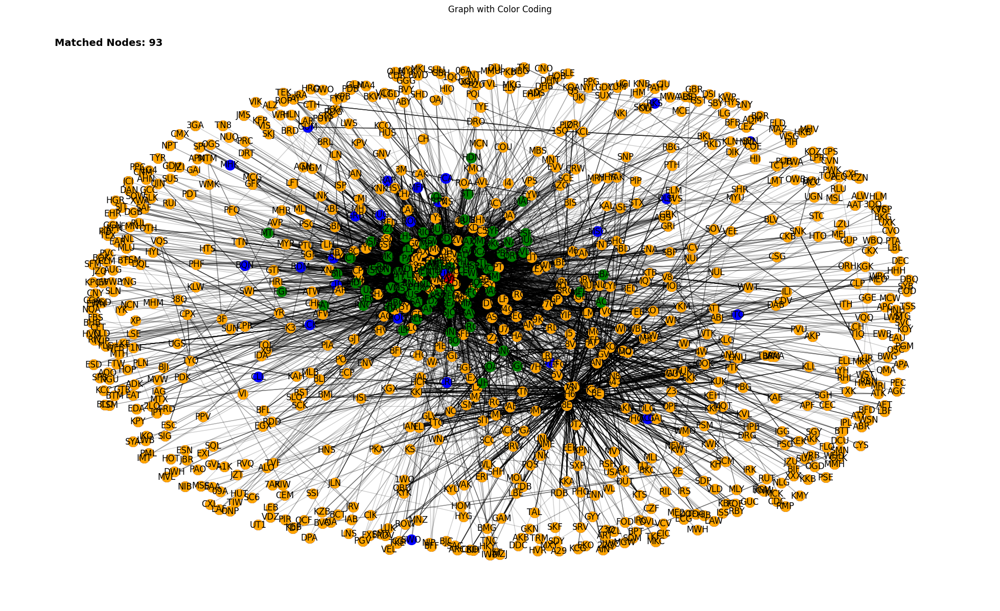

(826, 823, 93)

In [15]:
visualize_carrier_network(G, 'UA', 'AA')

### Function to check matching nodes between UA and B6

### Function to check matching nodes between UA and B6

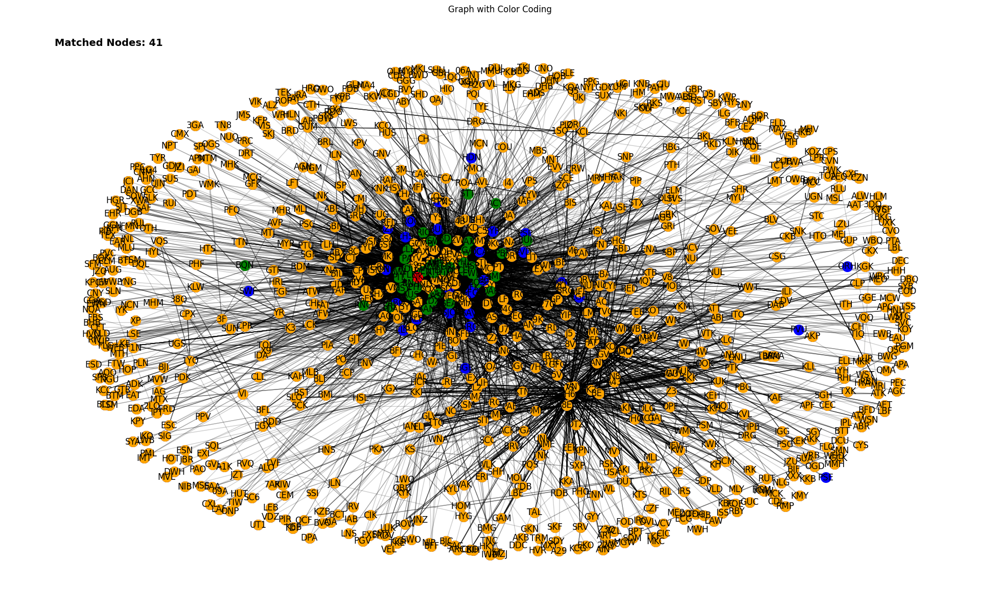

(889, 873, 41)

In [18]:
visualize_carrier_network(G, 'B6', 'NK')

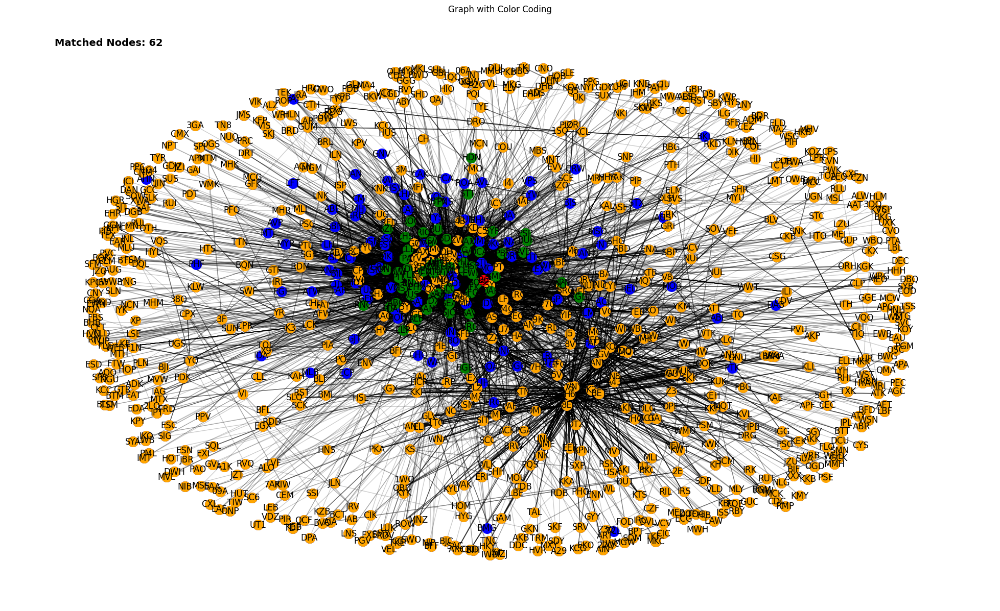

(873, 777, 62)

In [19]:
visualize_carrier_network(G, 'DL', 'B6')

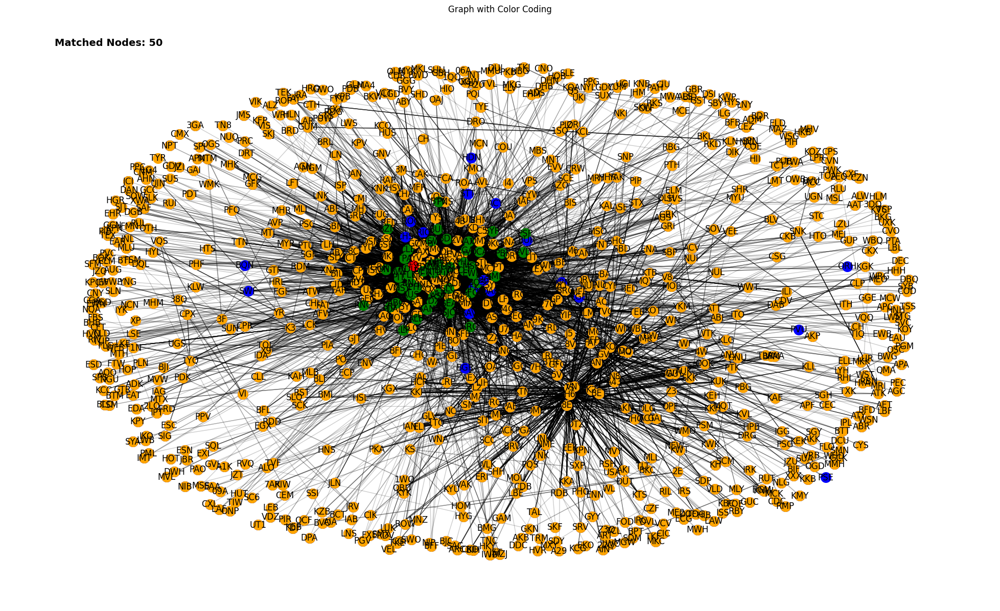

(849, 873, 50)

In [20]:
visualize_carrier_network(G, 'B6', 'F9')

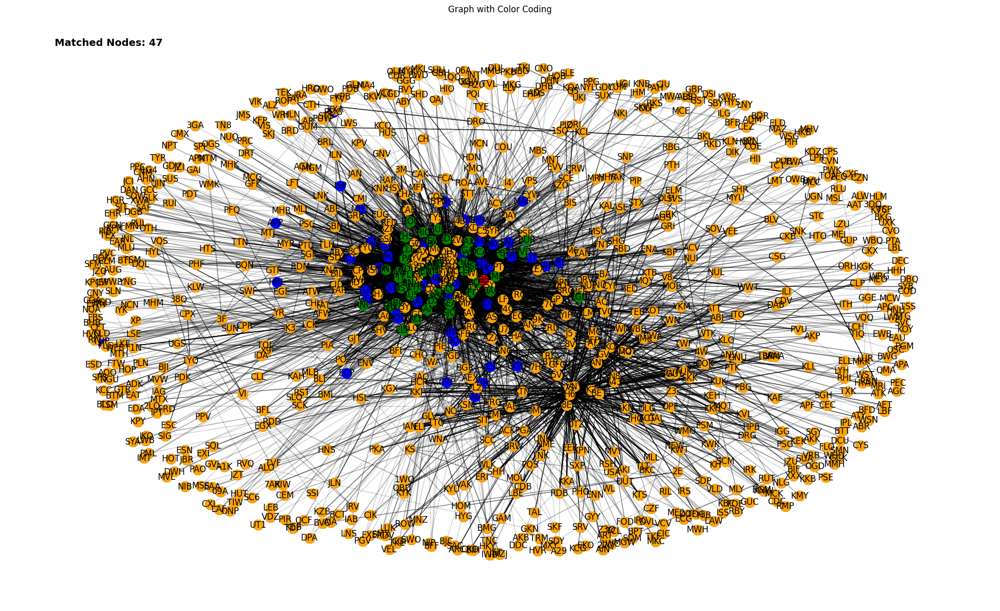

(873, 850, 47)

In [21]:
visualize_carrier_network(G, 'WN', 'B6')

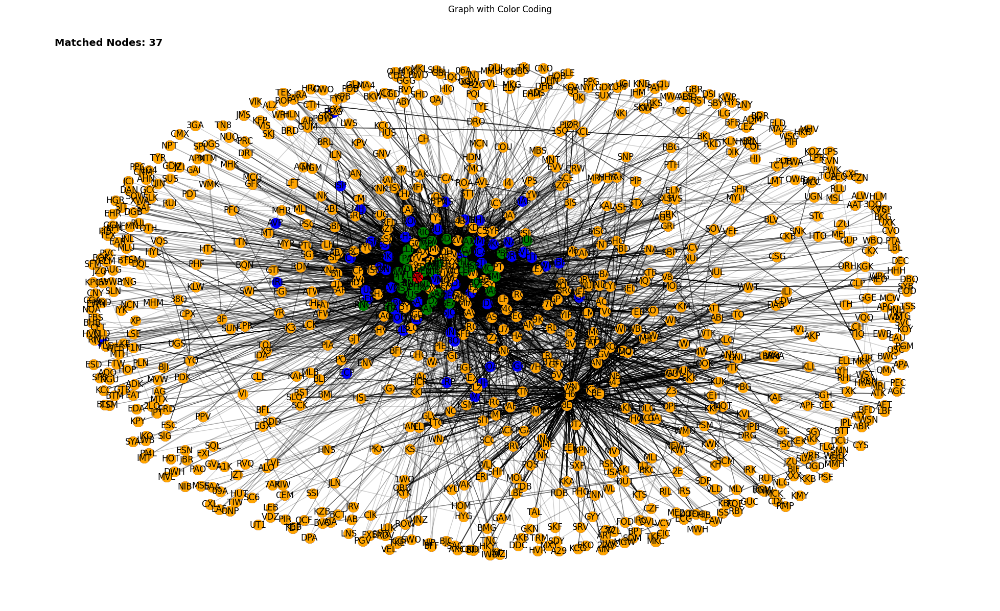

(889, 850, 37)

In [23]:
visualize_carrier_network(G, 'WN', 'NK')

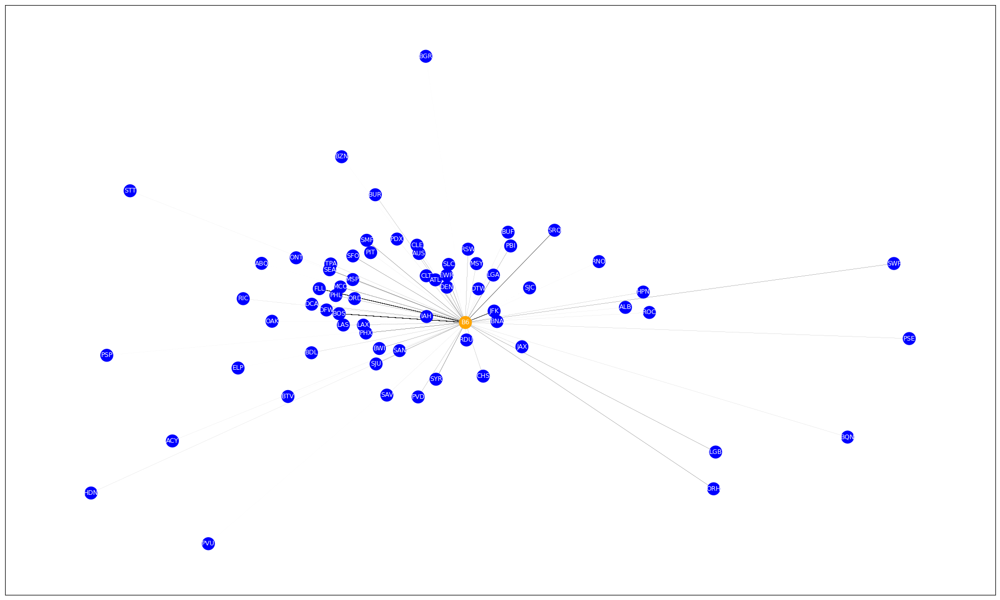

In [50]:
plt.figure(figsize=(25, 15))
G2 = nx.Graph()

central_node = 'B6'  # Replace 'A' with the actual node label you want to visualize
radius = 1

# Extract the subgraph within the specified radius
subgraph = nx.ego_graph(G, central_node, radius=radius)

# Define node colors for the central node and its neighbors
node_colors = ['orange' if node == central_node else 'blue' for node in subgraph.nodes()]

# Draw the subgraph
#pos = nx.spring_layout(subgraph, k=.7)  # Adjust the layout algorithm as desired
pos = nx.spring_layout(G, k=1, iterations=50)
nx.draw_networkx(subgraph, pos, with_labels=True, node_color=node_colors, edge_color='black',
    width=normalized_weights,  # Use the normalized weights as edge thickness
    font_size=9, font_color='white' )


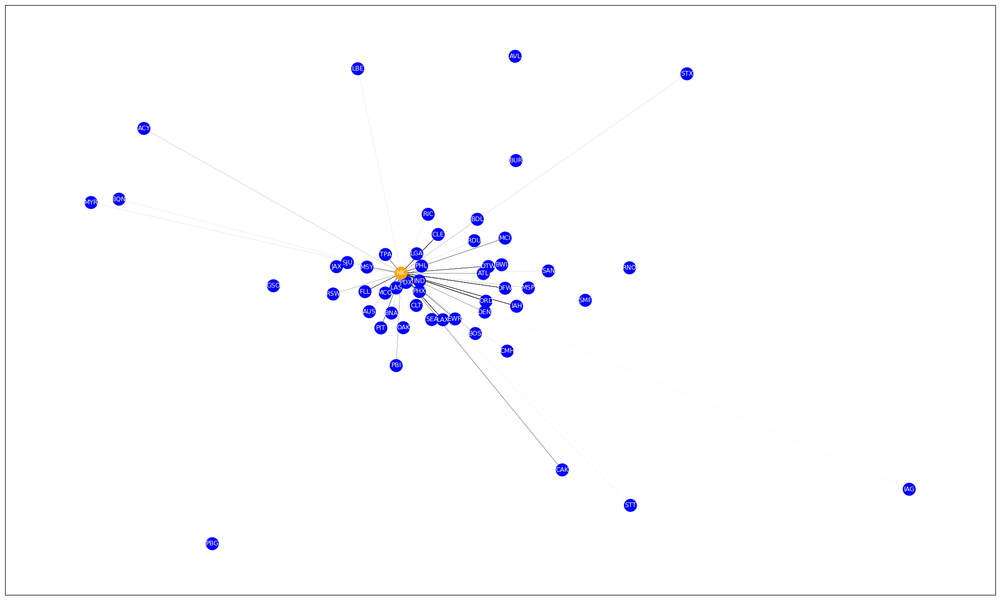

In [51]:
plt.figure(figsize=(25, 15))
G2 = nx.Graph()

central_node = 'NK'  # Replace 'A' with the actual node label you want to visualize
radius = 1

# Extract the subgraph within the specified radius
subgraph = nx.ego_graph(G, central_node, radius=radius)

# Define node colors for the central node and its neighbors
node_colors = ['orange' if node == central_node else 'blue' for node in subgraph.nodes()]

# Draw the subgraph
#pos = nx.spring_layout(subgraph, k=.7)  # Adjust the layout algorithm as desired
pos = nx.spring_layout(G, k=1, iterations=50)
nx.draw_networkx(subgraph, pos, with_labels=True, node_color=node_colors, edge_color='black',
    width=normalized_weights,  # Use the normalized weights as edge thickness
    font_size=9, font_color='white' )


## Island Method using Pax_Tranported Tresholds

In [28]:
def trim_edges(G, weight=1):
    G2 = nx.Graph()
    for f, to, edata in G.edges(data=True):
        if edata['Pax_Trasported'] > weight:
            G2.add_edge(f, to, **edata)
    return G2

def island_method(G, iterations=5):
    weights = [edata['Pax_Trasported'] for f, to, edata in G.edges(data=True)]
    mn = int(min(weights))
    mx = int(max(weights))
    step = int((mx - mn) / iterations)
    return [[threshold, trim_edges(G, threshold)] for threshold in range(mn, mx, step)]

cc = max(nx.connected_components(G), key=len)
islands = island_method(G.subgraph(cc))
for i in islands:
    threshold, subgraph = i
    num_nodes = len(subgraph)
    num_components = len(list(nx.connected_components(subgraph)))
    print(f"Threshold: {threshold}, Nodes: {num_nodes}, Components: {num_components}")


Threshold: 0, Nodes: 835, Components: 2
Threshold: 15370, Nodes: 83, Components: 1
Threshold: 30740, Nodes: 45, Components: 3
Threshold: 46110, Nodes: 19, Components: 3
Threshold: 61480, Nodes: 7, Components: 2


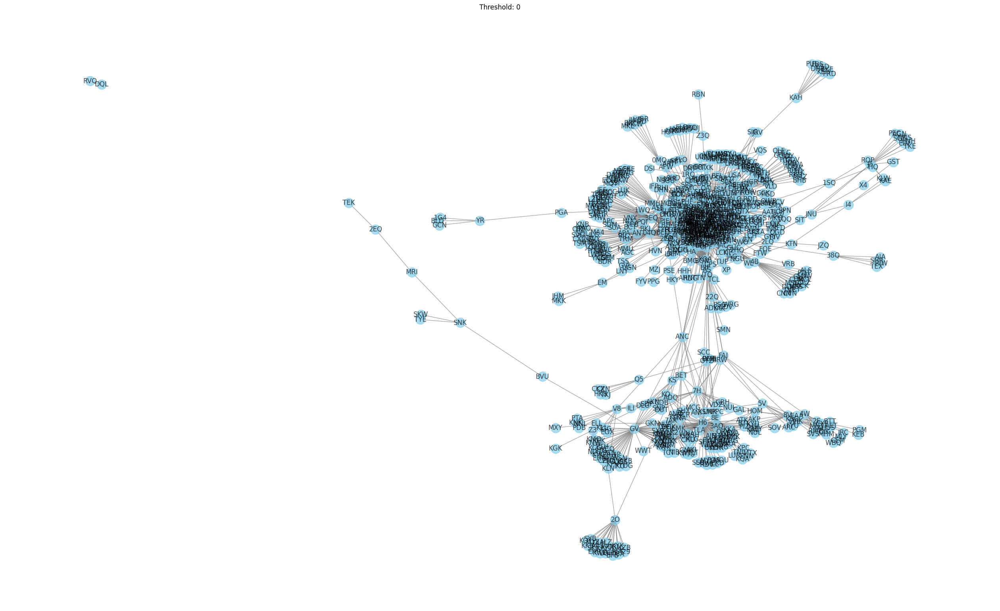

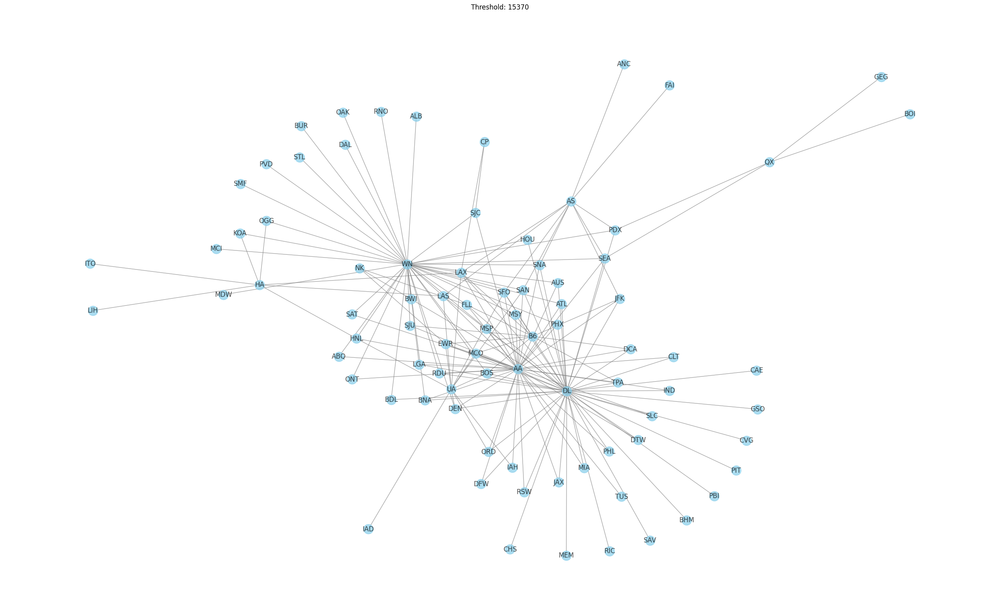

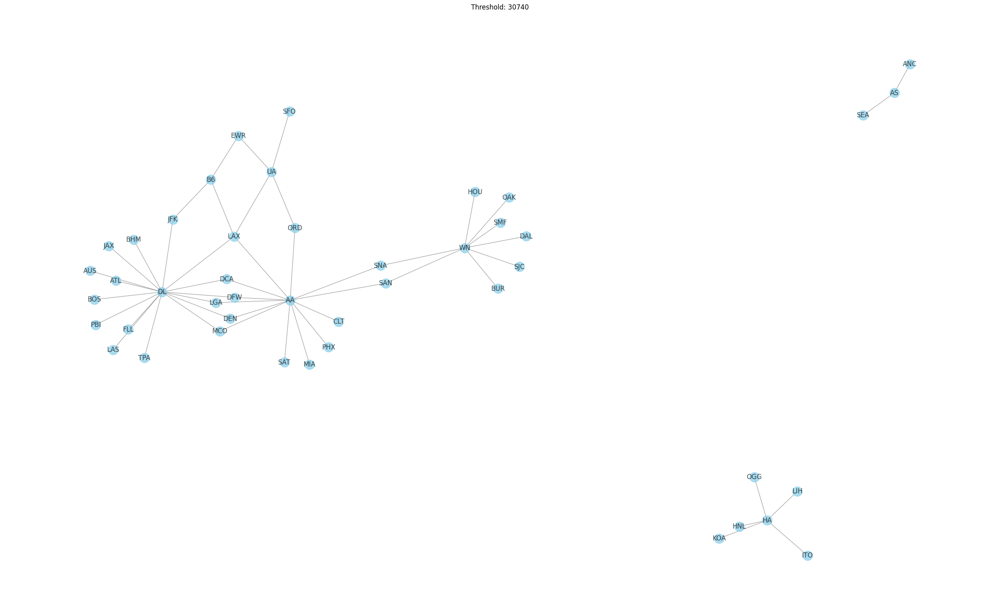

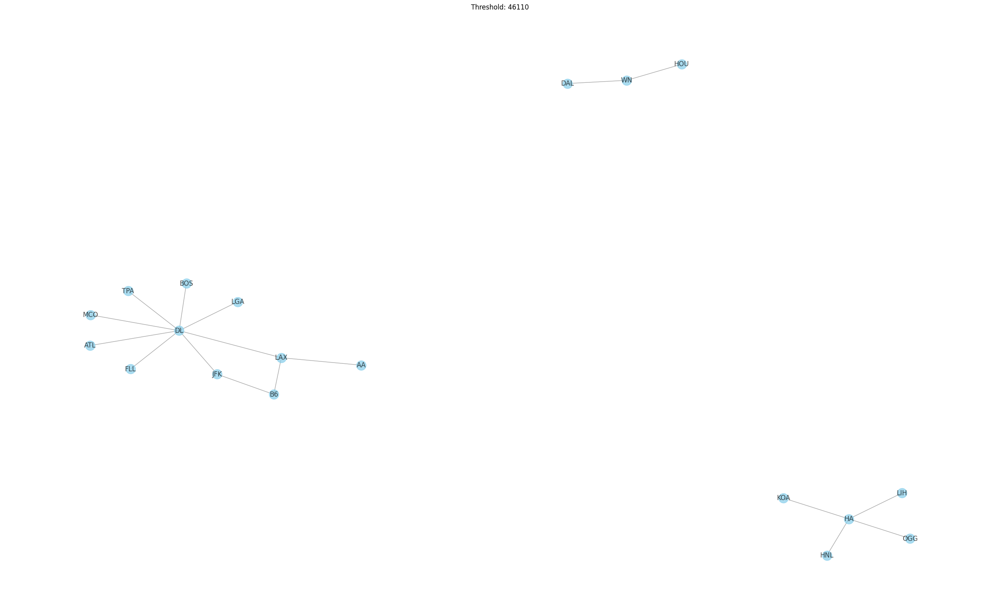

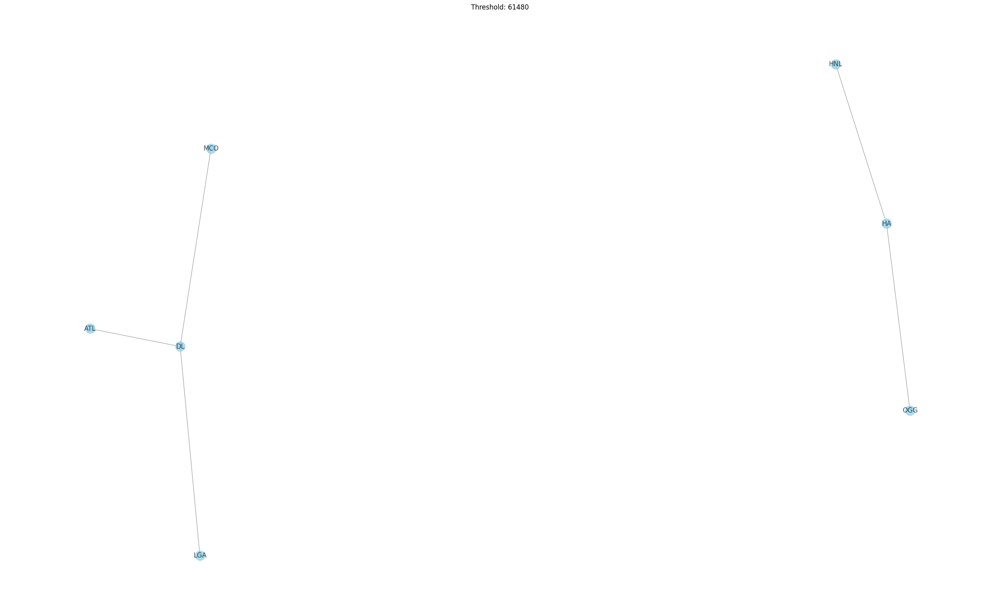

In [29]:
for i, (threshold, subgraph) in enumerate(islands):
    plt.figure(figsize=(25, 15))
    pos = nx.spring_layout(subgraph)  # Choose a layout for the subgraph
    nx.draw(subgraph, pos, with_labels=True, node_color='skyblue', edge_color='gray', alpha=0.7)
    plt.title(f"Threshold: {threshold}")
    plt.show()

## Next Steps: Use passenger load factors and time on the ground available to determine which Routes to Pursue and which routes to drop.